In [1]:
from benchmarking.analysis.analyze_results import *

In [2]:
impls = ["threaded", "asyncio", "vanilla"]
libs = ["torch", "lightning"]

In [3]:
def extract_metadata(
    output_base_folder: Path, folder_filter: str = "**", filter_by_metadata: Dict[str, List[str]] = None,
):
    files = list(output_base_folder.rglob(f"{folder_filter}/results-*.log"))
    data = []
    for working_file_path in tqdm.tqdm(files, total=len(files)):
        results = parse_results_log(working_file_path)
        if len(results) == 0:
            continue
        with (working_file_path.parent / "metadata.json").open("r") as f:
            metadata = json.load(f)
        if filter_by_metadata is not None:
            for k, v in filter_by_metadata.items():
                if metadata[k] not in v:
                    continue
        results = pd.DataFrame.from_records(data=results)

        for k, v in metadata.items():
            if not isinstance(v, (int, float, complex)):
                results[k] = str(v)
            else:
                results[k] = v

        results["source_file"] = working_file_path
        results["run"] = working_file_path.parent.name

        # filter out old data format missing dataset etc.
        if "dataset" not in results.columns:
            continue

        data.append(results)
    df = pd.concat(data)
    df.groupby
    return df

In [4]:
# setup folders
# output_base_folder = Path("/iarai/home/ivan.svogor/storage-benchmarking/benchmark_output/s3_debug")
# base_folder = "s3/*e2e*"
output_base_folder = Path("/iarai/home/ivan.svogor/storage-benchmarking/benchmark_output/s3_debug_epochs")
base_folder = "*e2e*"
df_dataloader_s3 = extract_timelines(output_base_folder, folder_filter=base_folder)


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 572/572 [00:02<00:00, 259.72it/s]


In [5]:
df_details_s3 = extract_metadata(output_base_folder, folder_filter=base_folder)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 572/572 [00:41<00:00, 13.72it/s]


In [6]:
# extract unique functions (for s3 and scratch, it's the same)
unique_functions_s3 = np.unique(df_dataloader_s3["item_x"])

# define colors for timelane items 
colors = {}
for i, color in zip(unique_functions_s3, ["red", "gold", "blue", "magenta", "aqua"]):
    colors[str(i)] = color
    
# define lanes (each lane is for a single function call (i.e. usage))
lanes={}
for i, lane in zip(unique_functions_s3, range(len(unique_functions_s3))):
    lanes[str(i)] = lane

# print to verify
print(f"Unique functions: {unique_functions_s3}")
print(f"Lanes: {lanes}")
    
# get the names of the runs for the iterators later on 
unique_runs_s3 = np.unique(df_dataloader_s3["run"])

Unique functions: ['batch' 'next_data' 'run_training_batch' 'training_batch_to_device']
Lanes: {'batch': 0, 'next_data': 1, 'run_training_batch': 2, 'training_batch_to_device': 3}


In [7]:
df_gpuutil_s3 = extract_gpuutil(output_base_folder, folder_filter=base_folder)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 572/572 [00:00<00:00, 4564.29it/s]


In [8]:
unique_runs_s3 = np.unique(df_dataloader_s3["run"])
print(unique_runs_s3)

['20220203f122134_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync'
 '20220203f122701_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync'
 '20220203f123135_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync'
 '20220203f123710_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync'
 '20220203f124229_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync'
 '20220203f125146_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync'
 '20220203f130044_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync'
 '20220203f131204_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync'
 '20220203f132138_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync'
 '20220203f134039_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync'
 '20220203f135849_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync'
 '20220203f141702_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync']


In [9]:
# df_details_s3[df_details_s3["run"]=]
# dataset_limit
for run in unique_runs_s3:
    print(f"{run},", df_details_s3[df_details_s3["run"]==run].get("dataset_limit").iloc[0])


20220203f122134_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync, 15000
20220203f122701_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync, 15000
20220203f123135_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync, 15000
20220203f123710_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync, 15000
20220203f124229_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync, 15000
20220203f125146_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync, 15000
20220203f130044_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync, 15000
20220203f131204_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync, 15000
20220203f132138_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync, 15000
20220203f134039_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync, 15000
20220203f135849_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync, 15000
20220203f141702_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync, 15000


In [10]:
df_dataloader_s3[df_dataloader_s3["run"]=="20220201f174051_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync"]

,item_x,id,start_time_x,item_y,end_time_y,source_file,run


64.9765625 38.239669421487605


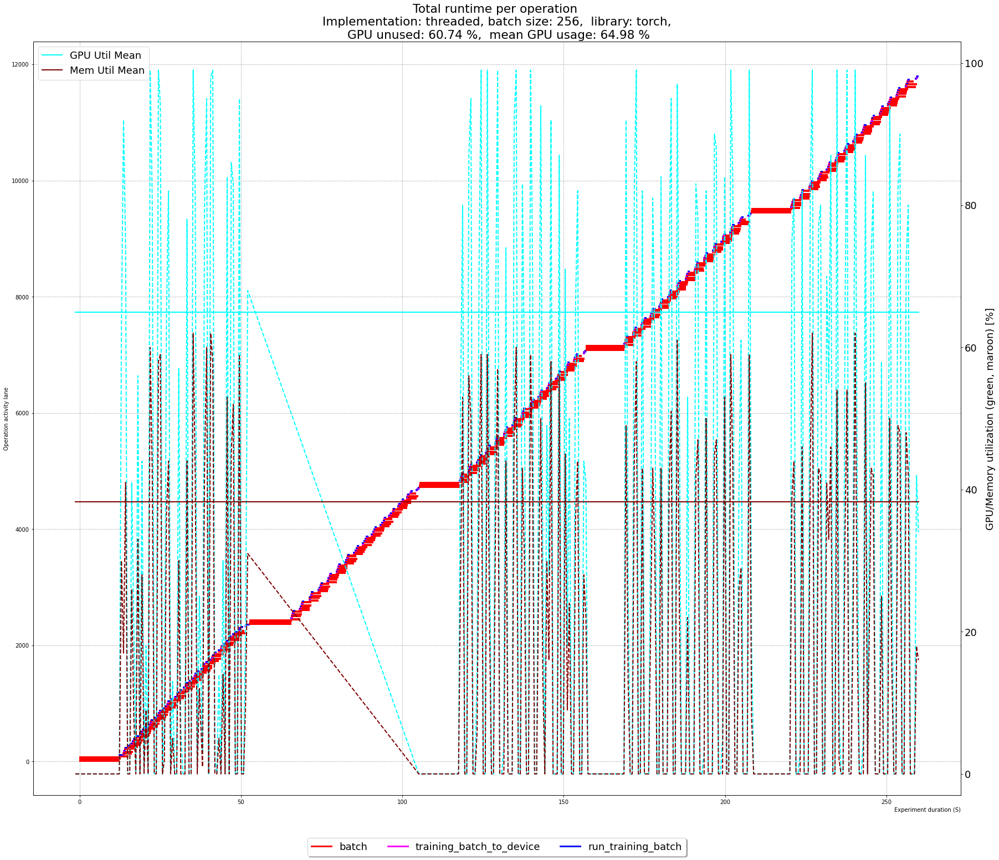

64.12765957446808 23.953488372093023


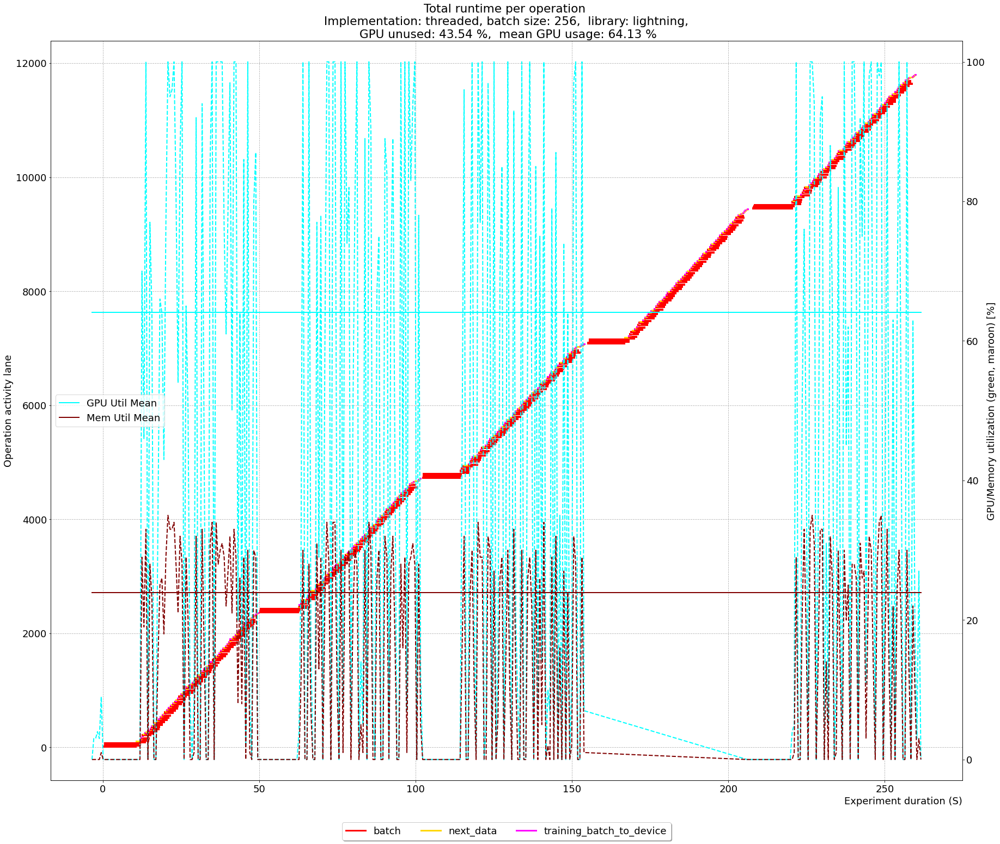

58.7 38.41721854304636


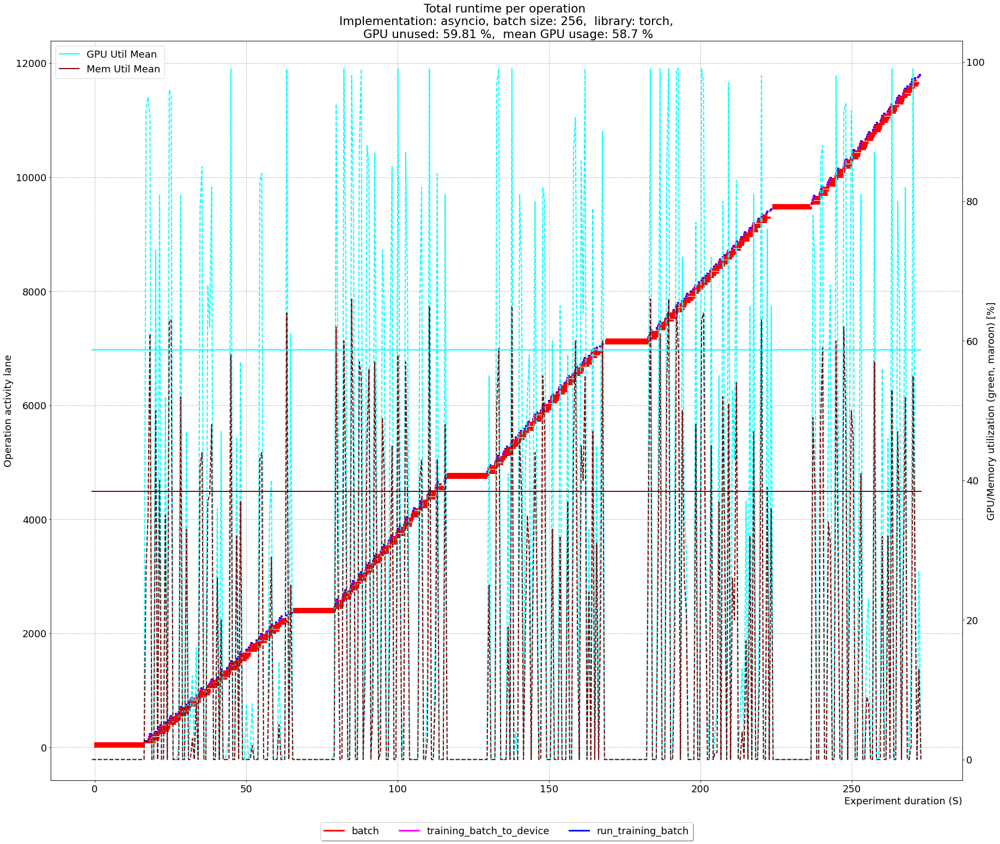

56.11538461538461 21.876623376623378


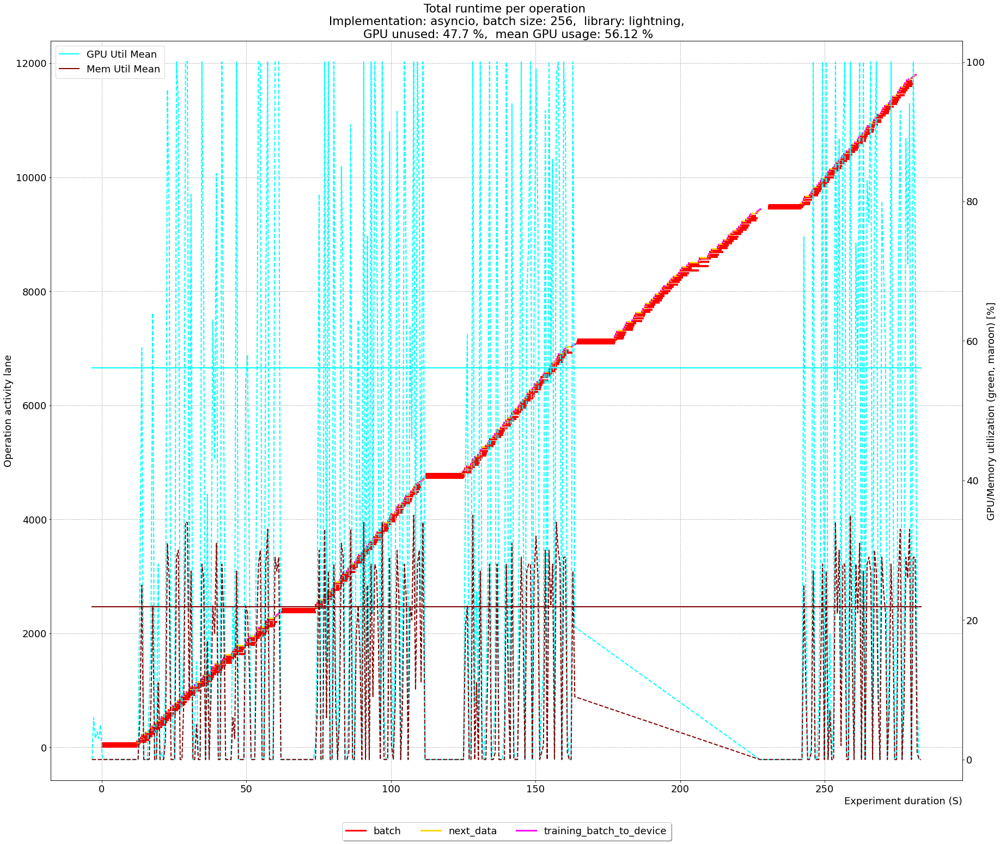

63.496688741721854 37.687943262411345


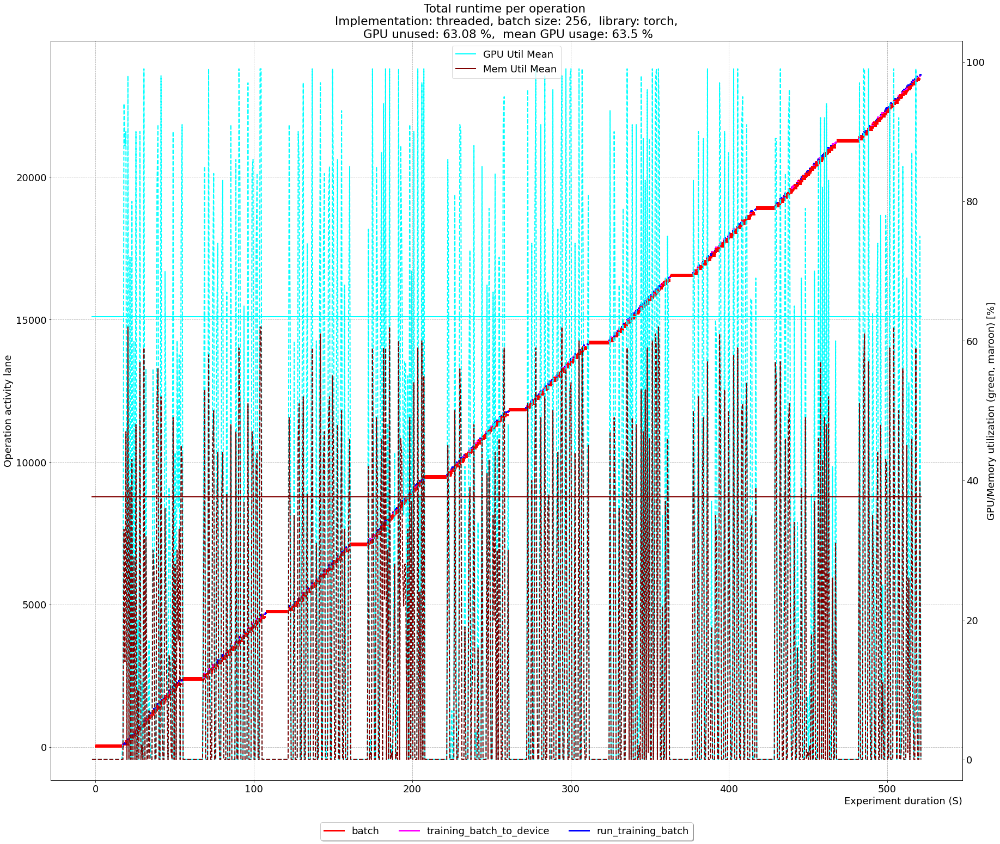

60.52247191011236 23.802588996763753


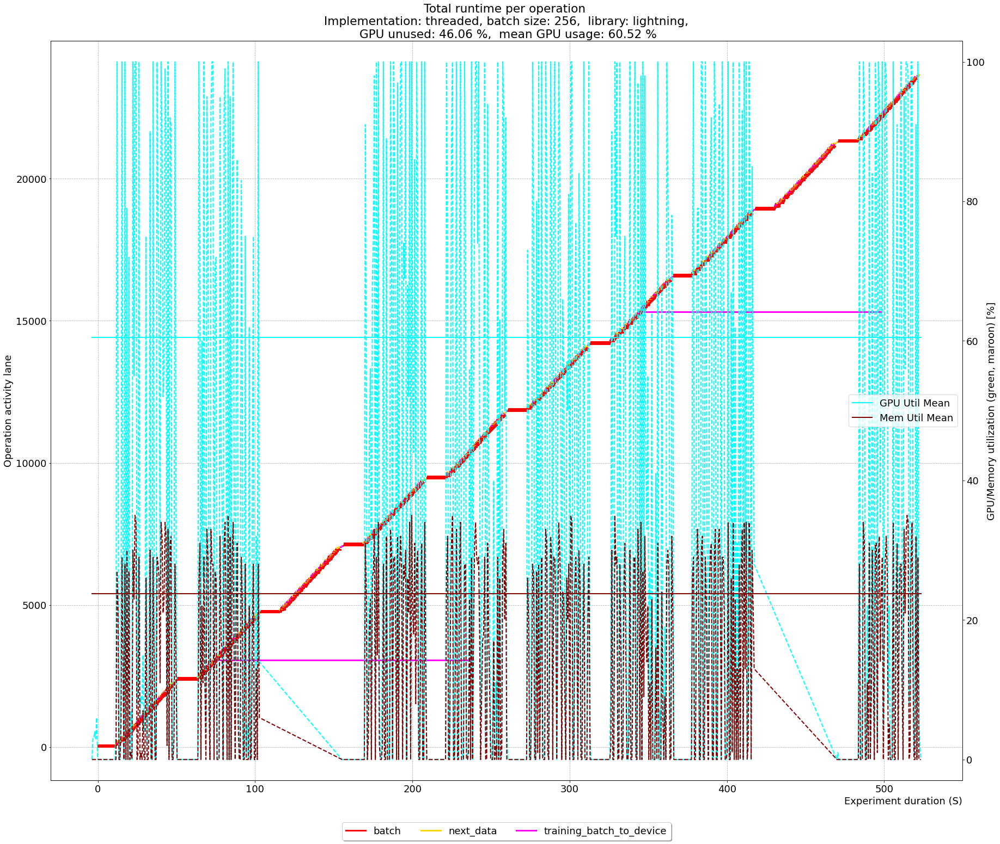

62.52447552447553 37.550943396226415


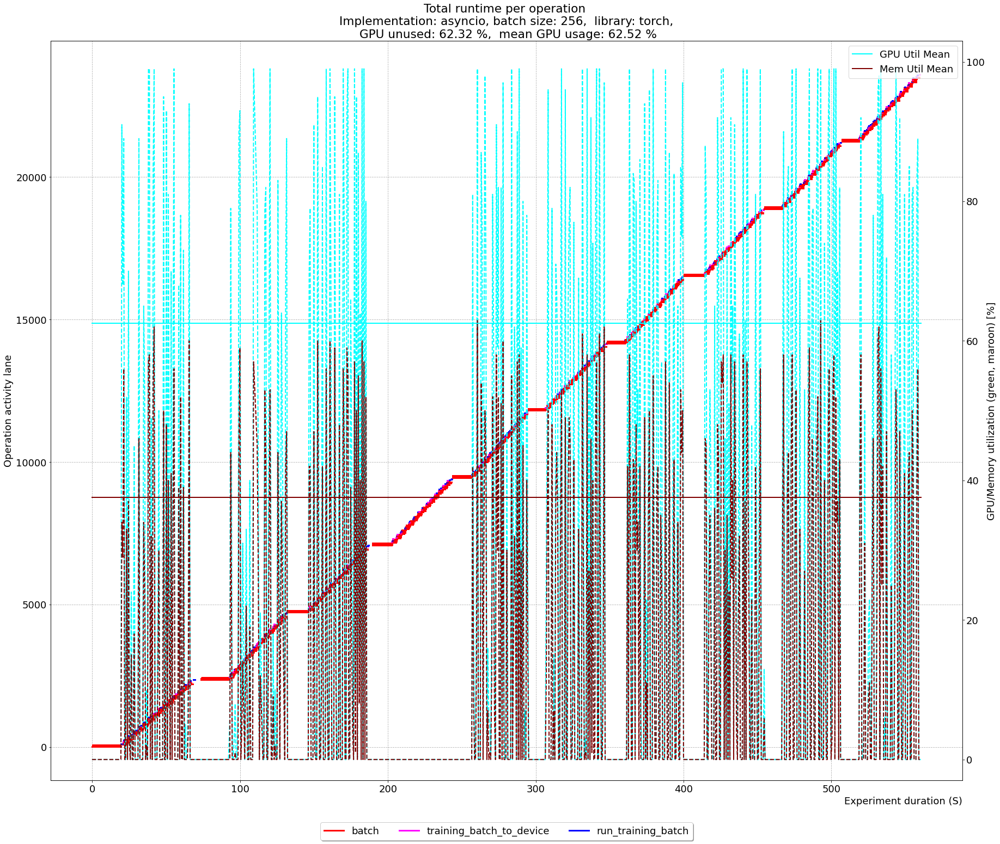

60.30444444444444 22.918575063613233


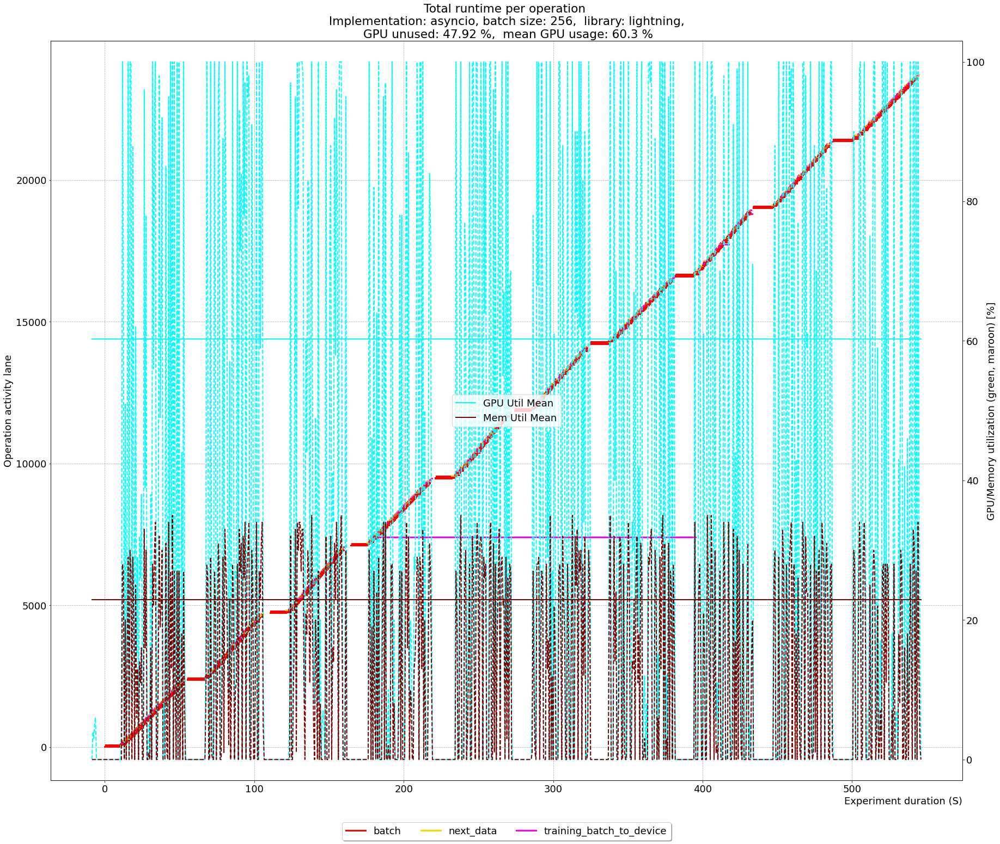

63.586583463338535 39.77408637873754


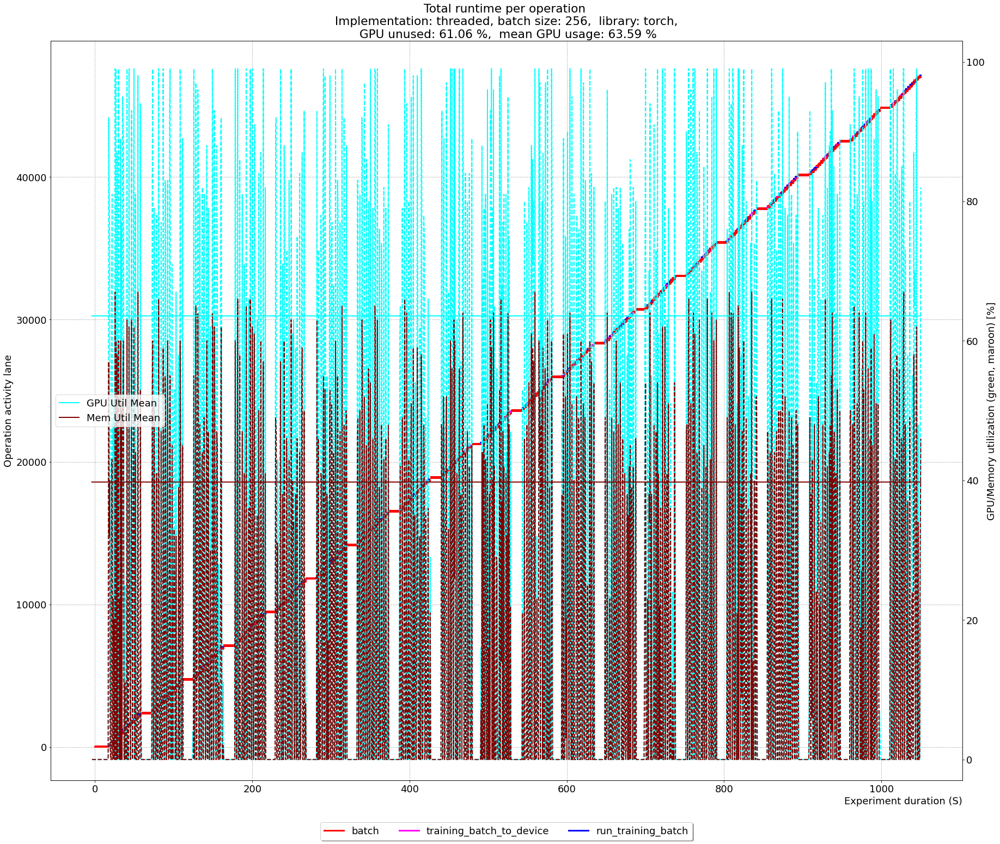

61.53904282115869 23.38385269121813


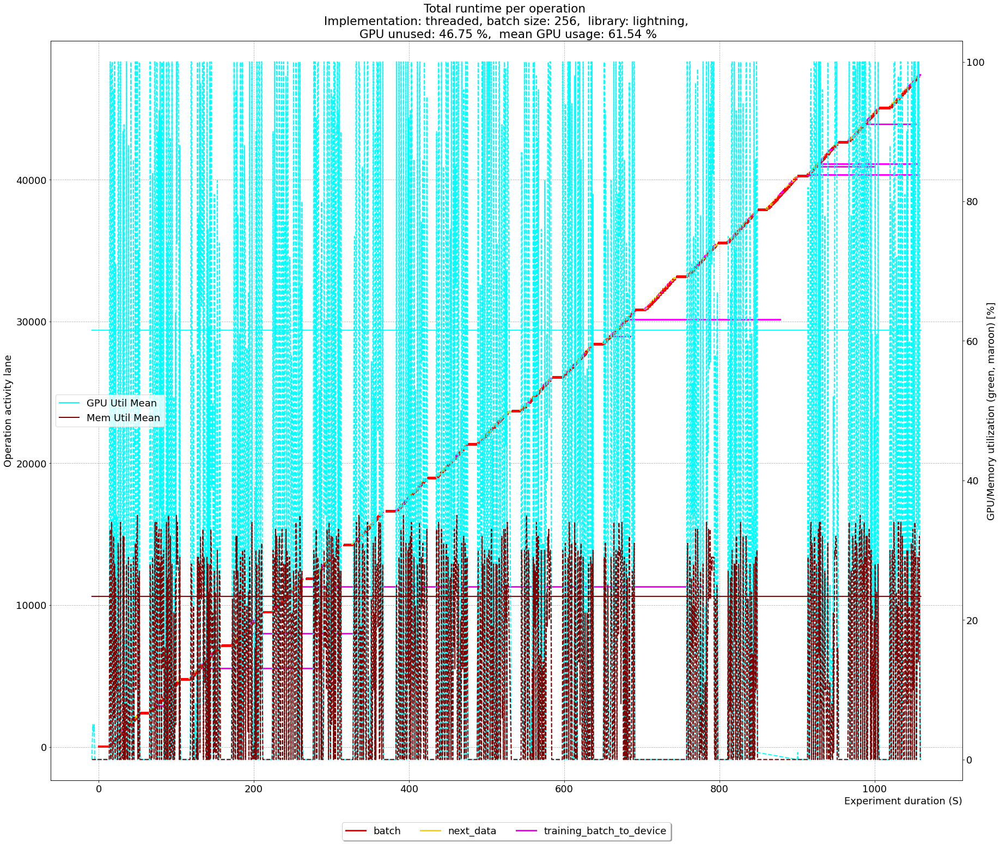

59.421875 35.64705882352941


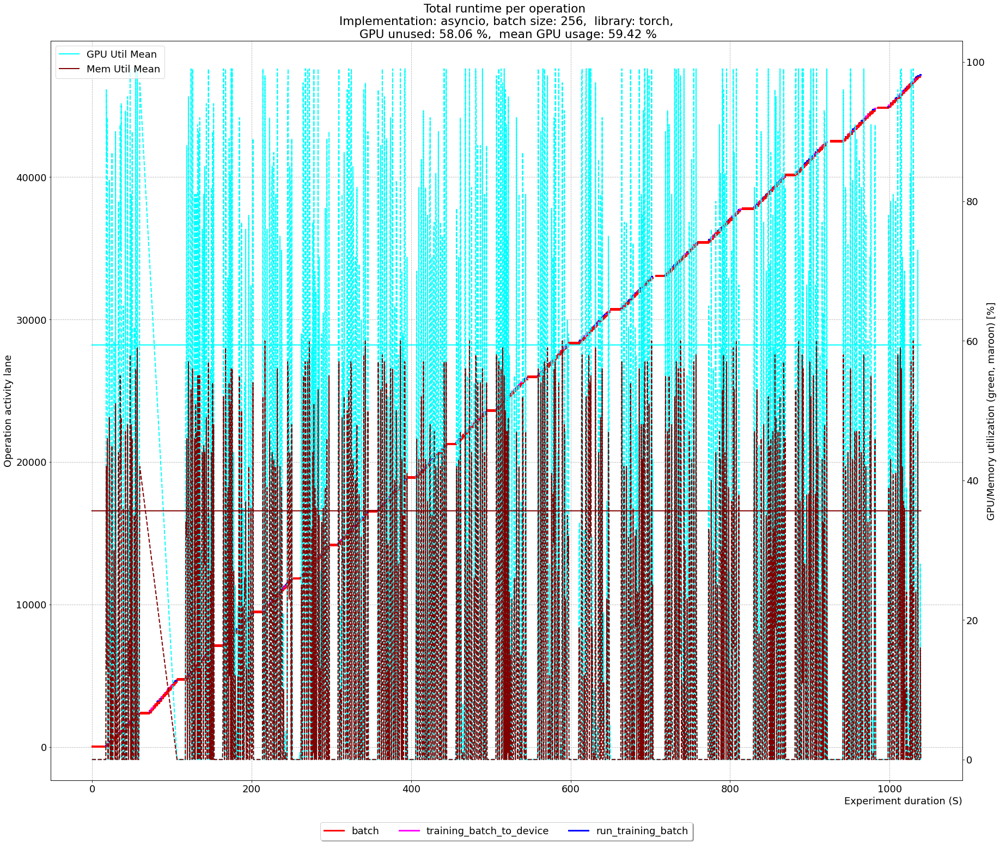

61.994432071269486 23.6007556675063


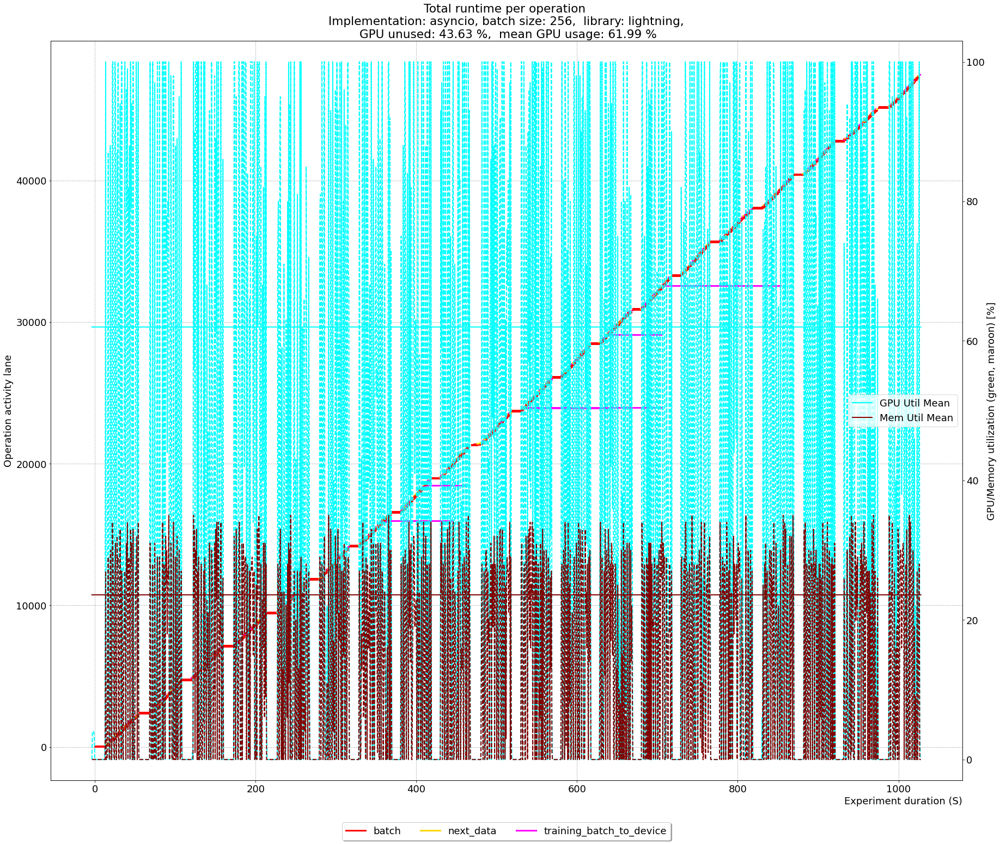

In [11]:
returns_s3 = []
for run in sorted(unique_runs_s3):
    df = df_dataloader_s3[df_dataloader_s3["run"]==run]
    dfgpu = df_gpuutil_s3[df_gpuutil_s3["run"]==run]
    r = show_timelines_with_gpu(df, dfgpu, lanes, colors, run, False, True, False, 2)
    r["dataset_limit"] = df_details_s3[df_details_s3["run"]==run].get("dataset_limit").iloc[0]
    r["epochs"] = df_details_s3[df_details_s3["run"]==run].get("epochs").iloc[0]
    returns_s3.append(r)

In [24]:
results = pd.DataFrame.from_records(data=returns_s3)
results["throughput"] = results["dataset_limit"] / (results["runtime"] / results["epochs"])
results.sort_values(["runtime", "library"], ascending=True).round(2)

,runtime,gpu_util_zero,gpu_util_mean_no_zeros,mem_util_mean,mem_util_mean_no_zeros,implementation,cache,library,dataset_limit,epochs,throughput
0,259.59,60.74,64.98,14.19,38.24,threaded,1,torch,15000,5,288.91
1,259.72,43.54,64.13,12.37,23.95,threaded,1,lightning,15000,5,288.78
2,272.43,59.81,58.70,13.71,38.42,asyncio,1,torch,15000,5,275.30
3,281.23,47.70,56.12,9.68,21.88,asyncio,1,lightning,15000,5,266.68
4,520.77,63.08,63.50,12.99,37.69,threaded,1,torch,15000,10,288.04
5,521.90,46.06,60.52,11.14,23.80,threaded,1,lightning,15000,10,287.41
7,544.53,47.92,60.30,10.42,22.92,asyncio,1,lightning,15000,10,275.47
6,559.83,62.32,62.52,13.11,37.55,asyncio,1,torch,15000,10,267.94
11,1026.37,43.63,61.99,11.76,23.60,asyncio,1,lightning,15000,20,292.29
10,1038.77,58.06,59.42,13.50,35.65,asyncio,1,torch,15000,20,288.80


[('threaded', 'torch'), ('threaded', 'lightning'), ('asyncio', 'torch'), ('asyncio', 'lightning'), ('threaded', 'torch'), ('threaded', 'lightning'), ('asyncio', 'torch'), ('asyncio', 'lightning'), ('threaded', 'torch'), ('threaded', 'lightning'), ('asyncio', 'torch'), ('asyncio', 'lightning')]
('threaded', 'torch')
('threaded', 'lightning')
('asyncio', 'torch')
('asyncio', 'lightning')
('threaded', 'torch')
('threaded', 'lightning')
('asyncio', 'torch')
('asyncio', 'lightning')
('threaded', 'torch')
('threaded', 'lightning')
('asyncio', 'torch')
('asyncio', 'lightning')


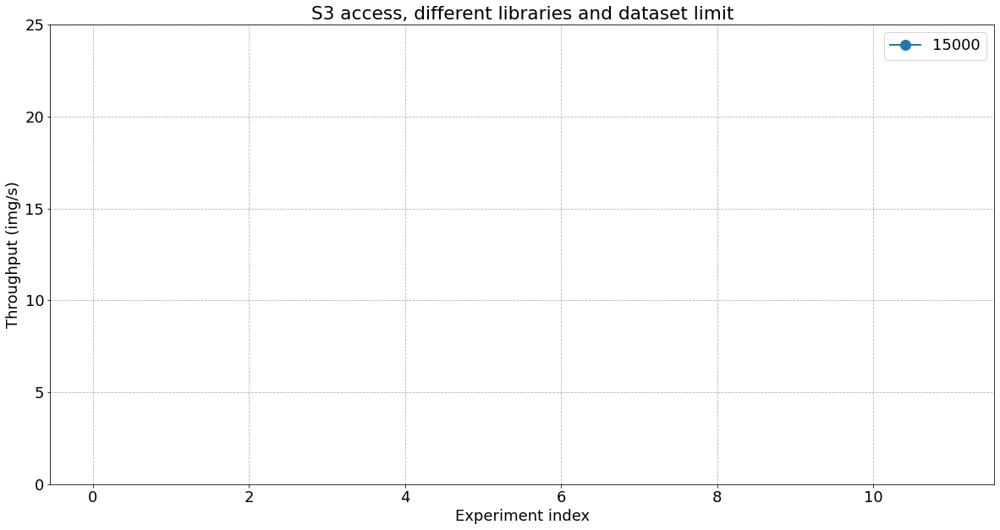

In [25]:
fig, ax = plt.subplots(figsize=(20, 10))
labels = []
for dataset_limit in np.unique(results["dataset_limit"]):
    data = results[(results["dataset_limit"] == dataset_limit) & (results["implementation"] != "vanilla")]
    y = list(data["throughput"])
    x = range(len(y))
    points = list(zip(data["implementation"], data["library"]))
    print(points)
    ax.plot(x, y, label=dataset_limit, marker='o', linewidth=2, markersize=12)
    for i, txt in enumerate(points):
        print(txt)
        ax.annotate(txt, (x[i], y[i]))
ax.set_xlabel("Experiment index", loc="center")
ax.set_ylabel("Throughput (img/s)", loc="center")
ax.set_ylim(0.0, 25.0)
ax.grid(linestyle="--", which="both")
ax.set_title("S3 access, different libraries and dataset limit")
ax.legend()

Epochs

[('threaded', 'torch'), ('threaded', 'lightning'), ('asyncio', 'torch'), ('asyncio', 'lightning')]
('threaded', 'torch')
('threaded', 'lightning')
('asyncio', 'torch')
('asyncio', 'lightning')
[('threaded', 'torch'), ('threaded', 'lightning'), ('asyncio', 'torch'), ('asyncio', 'lightning')]
('threaded', 'torch')
('threaded', 'lightning')
('asyncio', 'torch')
('asyncio', 'lightning')
[('threaded', 'torch'), ('threaded', 'lightning'), ('asyncio', 'torch'), ('asyncio', 'lightning')]
('threaded', 'torch')
('threaded', 'lightning')
('asyncio', 'torch')
('asyncio', 'lightning')


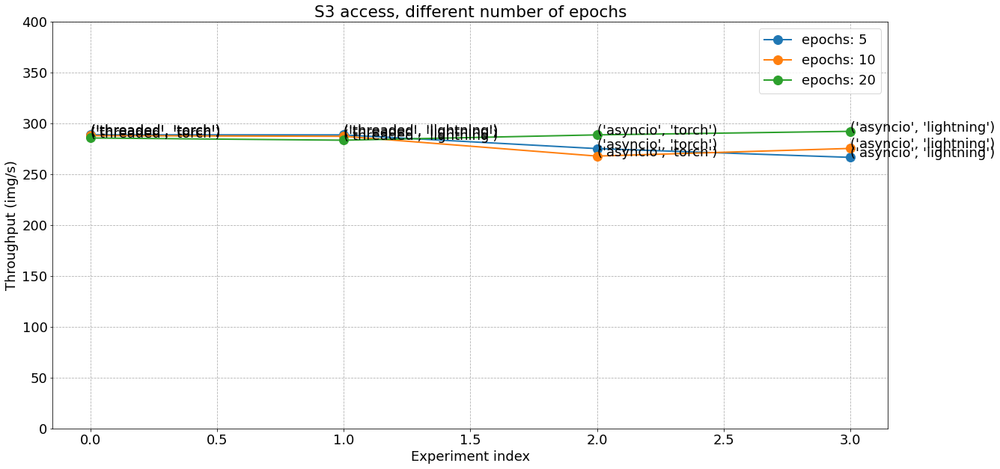

In [27]:
fig, ax = plt.subplots(figsize=(20, 10))
labels = []
for epochs in np.unique(results["epochs"]):
    data = results[(results["epochs"]==epochs) & (results["implementation"] != "vanilla")]
    y = list(data["throughput"])
    x = range(len(y))
    points = list(zip(data["implementation"], data["library"]))
    print(points)
    ax.plot(x, y, label=f"epochs: {epochs}", marker='o', linewidth=2, markersize=12)
    for i, txt in enumerate(points):
        print(txt)
        ax.annotate(txt, (x[i], y[i]))
ax.set_xlabel("Experiment index", loc="center")
ax.set_ylabel("Throughput (img/s)", loc="center")
ax.set_ylim(0.0, 400.0)
ax.grid(linestyle="--", which="both")
ax.set_title("S3 access, different number of epochs")
ax.legend()